## 探索查找异常数据
---


In [1]:
import os
os.chdir("{}/image".format(os.getcwd()))

#### I. 获取训练集中高度或者宽度小于50的图片。

In [2]:
from keras.preprocessing.image import img_to_array, load_img
import os
import numpy as np
import matplotlib.pyplot as plt

targetnames = os.listdir('train/')
bad_picture = []
for name in targetnames[1:]:
    img = load_img('train/'+name)
    x = img_to_array(img)
    if x.shape[0] < 50 or x.shape[1] < 50:
        bad_picture.append(name) 
print(bad_picture)

Using TensorFlow backend.


['dog.9705.jpg', 'dog.11686.jpg', 'cat.5527.jpg', 'cat.6402.jpg', 'cat.2433.jpg', 'dog.10747.jpg', 'dog.9246.jpg', 'cat.9171.jpg', 'dog.2652.jpg', 'cat.4821.jpg', 'dog.7011.jpg', 'dog.11248.jpg', 'cat.6614.jpg', 'cat.10392.jpg', 'cat.5534.jpg', 'dog.4367.jpg', 'dog.10733.jpg', 'dog.1324.jpg']


Len img_list: 18


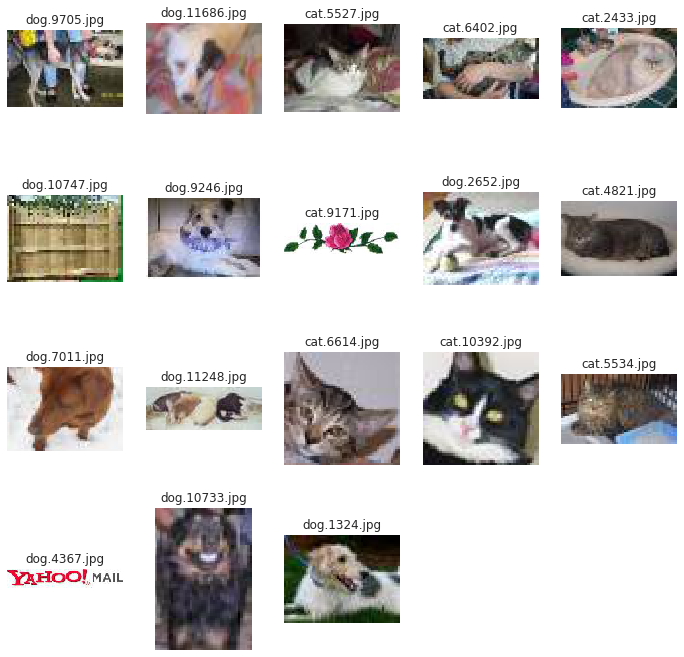

In [3]:
import matplotlib.pyplot as plt
from keras.preprocessing.image import load_img
# from keras.preprocessing import image
from math import ceil
plt.style.use('seaborn-white')
        
def show_img_list(img_list, size = (12, 12)):
    print("Len img_list: {}".format(len(img_list)))
    plt.figure(figsize=size)
    subplot_row = ceil(len(img_list) / 5)
    for i in range(0, len(img_list)):
        plt.subplot(subplot_row, 5, i+1)
        img = load_img('train/'+ img_list[i])
        plt.title(img_list[i])
        plt.axis('off')
        plt.imshow(img)
        
show_img_list(bad_picture)

##### 结论，非猫狗异常图片：dog.10747.jpg, cat.9171.jpg, dog.4367.jpg

#### II. 通过对图片中的色彩-像素比进行 IQR 分析(可发现很多分辨率低、无关的图片)

In [4]:
from PIL import Image
import os
import numpy as np
import shutil
from collections import Counter

targetnames = os.listdir('train/')
ratio_list = []

for name in targetnames[1:]:
    im = Image.open('train/' + name)
    x = im.histogram(mask=None)
    count = Counter(x)    
    ratio_list.append(float(len(count))/len(x))

In [5]:
import numpy as np

q99, q01 = np.percentile(ratio_list, [99, 1])

print(q99, q01)

0.8020833333333334 0.20052083333333334


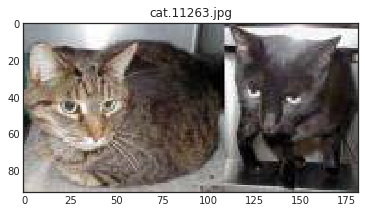

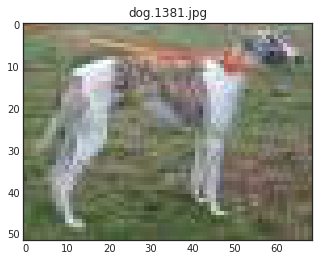

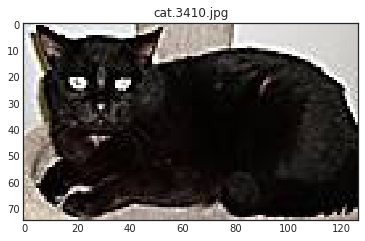

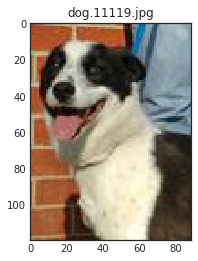

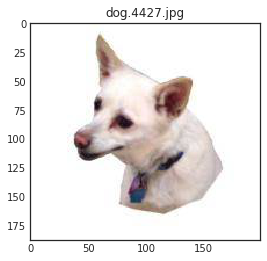

...

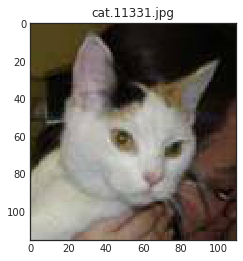

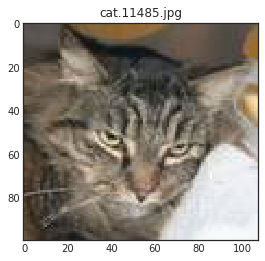

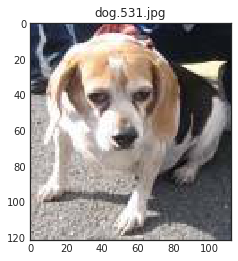

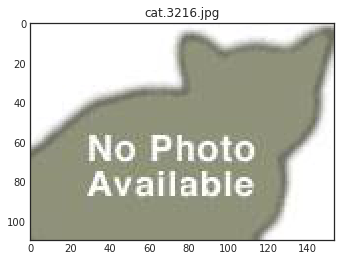

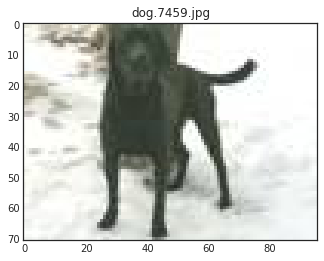

['cat.11263.jpg', 'dog.1381.jpg', 'cat.3410.jpg', 'dog.11119.jpg', 'dog.4427.jpg', 'dog.9512.jpg', 'cat.4994.jpg', 'dog.7378.jpg', 'cat.4577.jpg', 'dog.6473.jpg', 'dog.11609.jpg', 'cat.7314.jpg', 'dog.11747.jpg', 'dog.5427.jpg', 'cat.9967.jpg', 'dog.3088.jpg', 'cat.8138.jpg', 'cat.2165.jpg', 'dog.6299.jpg', 'dog.10989.jpg', 'dog.7374.jpg', 'dog.7322.jpg', 'cat.4363.jpg', 'cat.9624.jpg', 'dog.9288.jpg', 'dog.10190.jpg', 'dog.9705.jpg', 'cat.2691.jpg', 'dog.3536.jpg', 'cat.146.jpg', 'dog.3335.jpg', 'cat.9595.jpg', 'dog.11457.jpg', 'dog.296.jpg', 'dog.12331.jpg', 'dog.4507.jpg', 'dog.10729.jpg', 'cat.10925.jpg', 'dog.12.jpg', 'dog.11686.jpg', 'dog.6733.jpg', 'dog.69.jpg', 'cat.11045.jpg', 'cat.5527.jpg', 'cat.7703.jpg', 'cat.8848.jpg', 'cat.2674.jpg', 'cat.8534.jpg', 'dog.943.jpg', 'cat.6386.jpg', 'dog.4777.jpg', 'dog.3147.jpg', 'cat.4963.jpg', 'cat.4670.jpg', 'cat.8935.jpg', 'dog.1546.jpg', 'dog.5797.jpg', 'cat.10175.jpg', 'dog.9999.jpg', 'dog.5602.jpg', 'cat.11504.jpg', 'cat.6402.jpg', 

In [6]:
from keras.preprocessing.image import img_to_array, load_img
import shutil
import os
import matplotlib.pyplot as plt
from math import ceil
%matplotlib inline

plt.style.use('seaborn-white')

outlier_picture = []
targetnames = os.listdir('train/')
for name in targetnames[:]:
    im = Image.open('train/' + name)
    x = im.histogram(mask=None)
    count = Counter(x)
    if float(len(count))/len(x) < q01:
        outlier_picture.append(name)
        img = load_img('train/'+name)     
        plt.title(name)
        plt.imshow(img)
        plt.show()
        
print(outlier_picture)

##### 结论，非猫狗异常图片：cat.8456.jpg, dog.5604.jpg, dog.10747.jpg, dog.8736.jpg, cat.9171.jpg, dog.9517.jpg, cat.11184.jpg, dog.4367.jpg 


#### III. train数据集，采用预处理模型查找最可能不是猫狗的图片

In [7]:
import csv
import matplotlib.pyplot as plt
%matplotlib inline  

plt.style.use('seaborn-white')

def get_imageNet_class(file_path):
    category_class = []
    with open(file_path, 'r') as f:
        reader = csv.reader(f)
        for line in reader:
            if line[1] == '狗' or line[1] == '猫':
                category_class.append(line[0])
    return category_class

imageNet_class = get_imageNet_class('ImageNetClasses.csv')

In [8]:
from keras.models import *
from keras.layers import *
from keras.applications import *
from keras.preprocessing import image
from keras.applications.resnet50 import preprocess_input, decode_predictions
from keras.applications.inception_v3 import preprocess_input, decode_predictions
from keras.applications.xception import preprocess_input, decode_predictions
from keras.applications.inception_resnet_v2 import InceptionResNetV2,preprocess_input,decode_predictions


import numpy as np
import random
from math import ceil


def preprocess_input(x):
    return x - [103.939, 116.779, 123.68]

def get_outlier_predictions(MODEL, img_size, preprocess_input, decode_predictions):
    
    model = MODEL(weights='imagenet')
    outlier_predictions = {}
    targetnames = os.listdir('train/')
    for name in targetnames[:]:
        img = image.load_img('train/' + name, target_size=img_size)
        x = image.img_to_array(img)
        x = np.expand_dims(x, axis=0)
        x = preprocess_input(x)

        preds = model.predict(x)
        predictions = decode_predictions(preds, top=10)[0]
        #if predictions not in imageNet_class:
        #    outlier_predictions.append(name)
        outlier_predictions[name] = predictions
            
    return outlier_predictions    

In [9]:
import csv

def writer_csv(csv_path, data):
    """
    :type csv_path: str
    :type data: dict
    :rtype: None
    """
    with open(csv_path, 'w') as csv_file:
        writer = csv.writer(csv_file)
        for key, value in data.items():
            writer.writerow([key, value])
            
def readr_csv(csv_path):
    """
    :type cav_path: str
    :rtpye: dict
    """
    with open(csv_path, 'r') as csv_file:
        reader = csv.reader(csv_file)
        return dict(reader)
    
def get_result_list(pred):
    result = []
    for key, value in pred.items():
        value = eval(value)
        pred_list = [ x[0] for x in value ]
        pred_list = [ 1 for x in pred_list if x in imageNet_class ]
        if sum(pred_list) == 0:
            result.append(key)
        
    return result

In [10]:
import cv2
def plt_outlier_img_1(outlier_list, img_size):
    plt.figure(figsize=(16, 68), dpi=80)
    subplot_row = ceil(len(outlier_list) / 5)
    for i in range(0, len(outlier_list)):
        plt.subplot(subplot_row, 5, i+1)
        img = cv2.imread('train/'+ outlier_list[i])
        img = cv2.resize(img, img_size)
        x = img.copy()
        x.astype(np.float32)
        plt.title(outlier_list[i])
        plt.axis('off')
        plt.imshow(x[:,:,::-1])
        
#         img = image.load_img('train/'+ outlier_list[i])
#         x = image.img_to_array(img)
#         plt.title(outlier_list[i])
#         #plt.axis('off')
#         plt.tight_layout()
#         plt.imshow(img)

In [11]:
csv_path = 'train_decode_predictions.csv'

In [12]:
def get_outlier_result(MODEL, img_size, preprocess_input, decode_predictions):
    
    
    outlier_list = get_outlier_predictions(MODEL, img_size, preprocess_input, decode_predictions)

    writer_csv(csv_path, outlier_list)
    
    outlier_list = readr_csv(csv_path)
    len(outlier_list)
    
    outlier_result = get_result_list(outlier_list)
    len(outlier_result)
    
    return outlier_result

# targetnames = os.listdir('image/train/')

In [13]:
def get_counts_cat_dog(result_list):
    
    n = len(result_list)
    cat = 0
    dog = 0
    for filename in result_list:
        name = filename[0: 3]
        if(name == 'cat'):
            cat += 1 
        elif(name == 'dog'):
            dog += 1 
        else:
            return    
    print('all = {}, cat = {}, dog = {}'.format(n, cat, dog))
    return n, cat, dog

注意： 运行下面的代码，下载预训练模型可能会网络超时，例如：Exception: URL fetch failure on https://github.com/fchollet/deep-learning-models/releases/download/v0.4/xception_weights_tf_dim_ordering_tf_kernels_notop.h5: None -- [Errno 110] Connection timed out 

此时，需要手动下载先对应的模型文件，放到~/.keras/models/ 文件路径下，即可。

Instructions for updating:
keep_dims is deprecated, use keepdims instead
all = 250, cat = 191, dog = 59


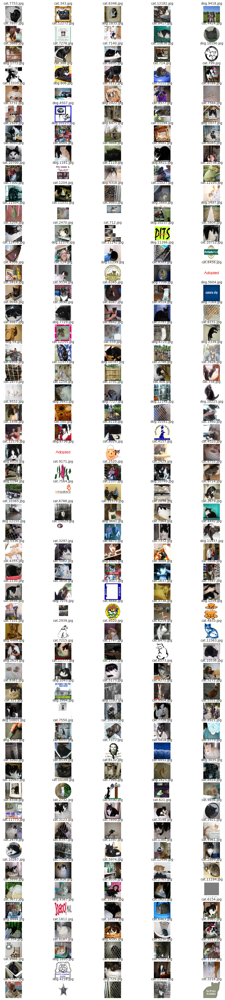

In [14]:
resnet50_result = get_outlier_result(ResNet50, (224, 224), resnet50.preprocess_input, resnet50.decode_predictions)
get_counts_cat_dog(resnet50_result)
plt_outlier_img_1(resnet50_result, (224, 224))

异常图片为：
['dog.1773.jpg', 'dog.6475.jpg', 'dog.12376.jpg','dog.10237.jpg', 'cat.10712.jpg',
 'dog.10747.jpg','dog.11299.jpg', 'cat.8456.jpg', 'dog.5604.jpg', 'dog.8736.jpg',
 'cat.9171.jpg', 'cat.7564.jpg', 'dog.9517.jpg', 'dog.2614.jpg', 'dog.1043.jpg',
 'cat.5351.jpg', 'dog.10801.jpg', 'cat.7377.jpg', 'cat.5418.jpg', 'cat.4338.jpg',
 'cat.11184.jpg','dog.4367.jpg']
 
 背景复杂，可疑异常图片为:
 ['cat.10029.jpg', 'dog.9418.jpg', 'cat.12272.jpg', 'dog.1835.jpg', 'cat.3868.jpg','cat.10636.jpg', 'cat.3731.jpg', 'dog.4507.jpg', 'dog.10123.jpg','cat.10700.jpg', 'dog.1161.jpg', 'dog.3889.jpg', 'cat.4308.jpg', 'dog.59.jpg', 'dog.6725.jpg', 'dog.7727.jpg', 'dog.10161.jpg', 'dog.9681.jpg', 'cat.7372.jpg', 'dog.11437.jpg', 'dog.6405.jpg', 'cat.9520.jpg', 'dog.3994.jpg','cat.7550.jpg', 'cat.3672.jpg', 'dog.4218.jpg']

Instructions for updating:
keep_dims is deprecated, use keepdims instead
all = 122, cat = 89, dog = 33


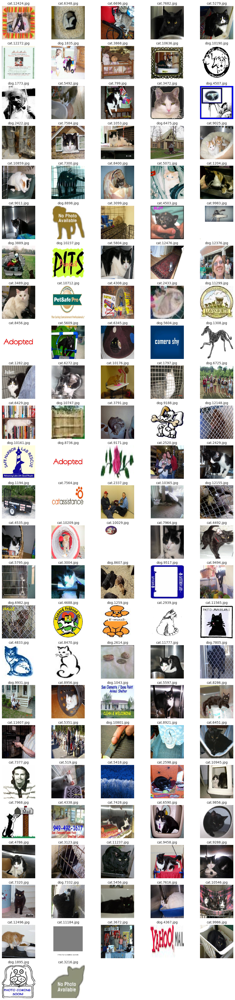

In [16]:
xception_result = get_outlier_result(Xception, (299, 299), xception.preprocess_input, xception.decode_predictions)
get_counts_cat_dog(xception_result)
plt_outlier_img_1(xception_result, (299, 299))

异常图片为：

['dog.1773.jpg', 'dog.6475.jpg', 'dog.10237.jpg', 'dog.12376.jpg', 'cat.10712.jpg',
 'dog.10747.jpg', 'dog.11299.jpg', 'cat.8456.jpg', 'dog.5604.jpg', 'dog.8736.jpg',
 'cat.9171.jpg', 'cat.7564.jpg', 'dog.9517.jpg', 'dog.2614.jpg', 'dog.1043.jpg',
 'cat.5351.jpg', 'dog.10801.jpg','cat.7377.jpg', 'cat.5418.jpg','cat.4338.jpg',
 'cat.11184.jpg','dog.4367.jpg']

all = 191, cat = 152, dog = 39


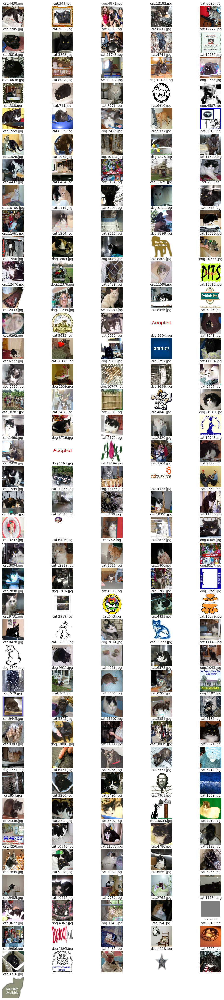

In [17]:
inceptionV3_result = get_outlier_result(InceptionV3, (299, 299), inception_v3.preprocess_input, inception_v3.decode_predictions)
get_counts_cat_dog(inceptionV3_result)
plt_outlier_img_1(inceptionV3_result, (299, 299))

异常图片为：

['cat.1773.jpg', 'dog.6475.jpg', 'dog.10237.jpg', 'dog.12376.jpg', 'cat.10712.jpg',
 'dog.11299.jpg','cat.8456.jpg','dog.5604.jpg','dog.10747.jpg','dog.8736.jpg',
 'cat.9171.jpg','dog.1194.jpg','cat.7564.jpg','dog.9517.jpg','dog.2614.jpg',
 'dog.1043.jpg','cat.5351.jpg','dog.10801.jpg','cat.7377.jpg','cat.5418.jpg',
 'cat.4338.jpg', 'cat.11184.jpg', 'dog.4367.jpg']

all = 271, cat = 236, dog = 35


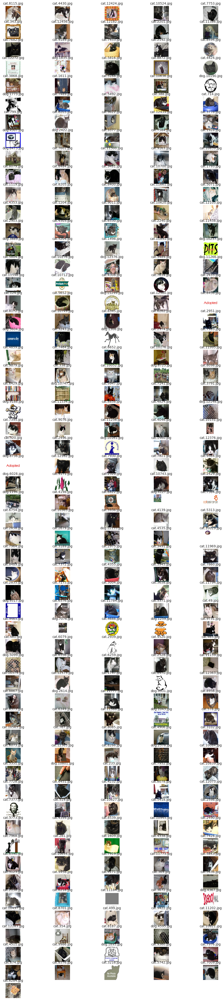

In [18]:
inceptionresnetv2_result = get_outlier_result(InceptionResNetV2, (299, 299), inception_resnet_v2.preprocess_input, inception_resnet_v2.decode_predictions)
get_counts_cat_dog(inceptionresnetv2_result)
plt_outlier_img_1(inceptionresnetv2_result, (299, 299))

异常图片为：

['dog.1773.jpg','dog.6475.jpg','dog.10237.jpg','dog.12376.jpg','cat.10712.jpg',
 'dog.11299.jpg','cat.8456.jpg','dog.5604.jpg','dog.10747.jpg','dog.8736.jpg',
 'cat.9171.jpg','dog.1194.jpg','cat.7564.jpg','dog.9517.jpg','dog.2614.jpg',
'dog.1043.jpg','cat.5351.jpg','dog.10801.jpg','cat.7377.jpg','cat.5418.jpg',
 'cat.4338.jpg','cat.11184.jpg', 'dog.4367.jpg']


#### IV. 综合上面查找的结果，手动把可疑异常图片挑选出来

bad pictrues all: 23


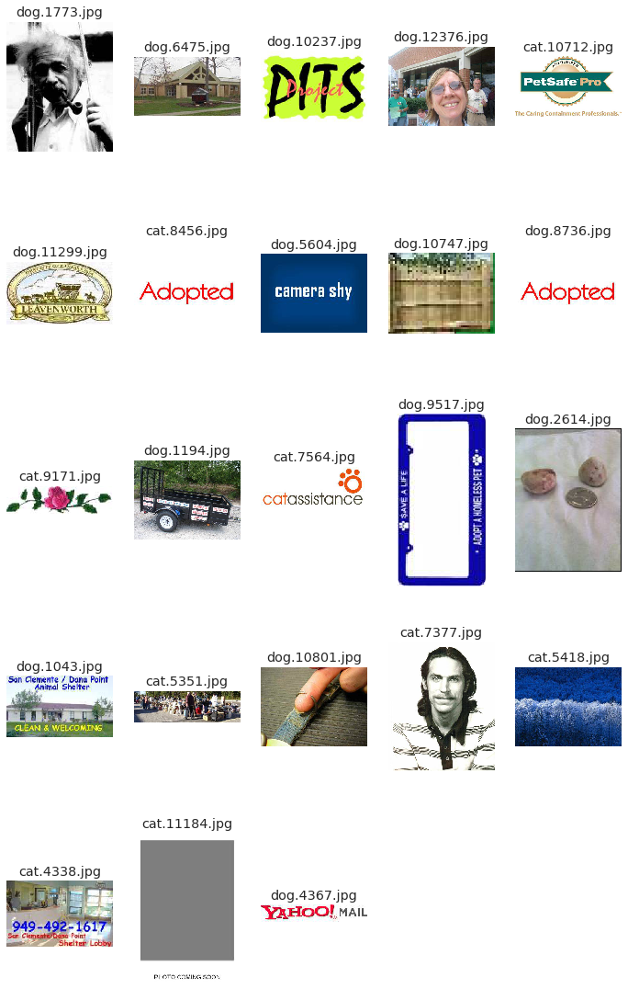

In [32]:
import shutil

bad_picture_list = ['dog.1773.jpg','dog.6475.jpg','dog.10237.jpg','dog.12376.jpg','cat.10712.jpg',
                    'dog.11299.jpg','cat.8456.jpg','dog.5604.jpg','dog.10747.jpg','dog.8736.jpg',
                    'cat.9171.jpg','dog.1194.jpg','cat.7564.jpg','dog.9517.jpg','dog.2614.jpg',
                    'dog.1043.jpg','cat.5351.jpg','dog.10801.jpg', 'cat.7377.jpg','cat.5418.jpg',
                    'cat.4338.jpg','cat.11184.jpg', 'dog.4367.jpg']

def show_img_list(img_list, size = (12, 12)):
    print("bad pictrues all: {}".format(len(img_list)))
    plt.figure(figsize=size)
    subplot_row = ceil(len(img_list) / 5)
    for i in range(0, len(img_list)):
        plt.subplot(subplot_row, 5, i+1)
        img = image.load_img('train/'+ img_list[i])
        plt.title(img_list[i])
        plt.axis('off')
        plt.imshow(img)
        
show_img_list(bad_picture_list, (12,20))


移除异常图片

In [25]:
import shutil

for i in range(0, len(bad_picture_list)):
    shutil.move('train/' + bad_picture_list[i], 'outlier/' + bad_picture_list[i])

In [33]:
import os
import shutil

train_filenames = os.listdir('train')
train_cat = filter(lambda x:x[:3] == 'cat', train_filenames)
train_dog = filter(lambda x:x[:3] == 'dog', train_filenames)

def rmrf_mkdir(dirname):
    if os.path.exists(dirname):
        shutil.rmtree(dirname)
    os.mkdir(dirname)

rmrf_mkdir('img_train')
os.mkdir('img_train/cat')
os.mkdir('img_train/dog')

rmrf_mkdir('img_test')
os.symlink('../test/', 'img_test/test')

for filename in train_cat:
    os.symlink('../../train/'+filename, 'img_train/cat/'+filename)

for filename in train_dog:
    os.symlink('../../train/'+filename, 'img_train/dog/'+filename)

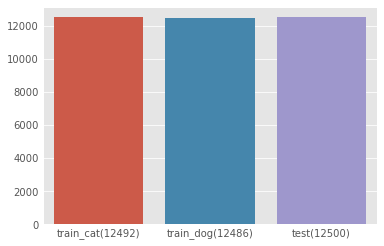

In [39]:
import seaborn as sns
plt.style.use('ggplot')

train_cats = 'train_cat({})'.format(len(os.listdir('img_train/cat')))
train_dogs = 'train_dog({})'.format(len(os.listdir('img_train/dog')))
test_title = 'test({})'.format(len(os.listdir('test')))
                               
x = [train_cats, train_dogs, test_title]
y = [len(os.listdir('img_train/cat')), len(os.listdir('img_train/dog')), len(os.listdir('test'))]
ax = sns.barplot(x=x, y=y)